# Dataset Preprocessing

### Library loading

In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from scipy import sparse
from anndata import AnnData
import warnings
import socket
from matplotlib import pylab

import yaml
import os
warnings.filterwarnings('ignore')

In [2]:
import ipynbname
try:
    nb_fname = ipynbname.name()
except:
    nb_fname = "".join(os.path.basename(globals()["__vsc_ipynb_file__"]).split(".")[:-1])

In [3]:
%matplotlib inline

In [4]:
sc.settings.verbosity = 3         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=50, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (9, 9)


scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.13.1 python-igraph==0.9.8 louvain==0.7.1 pynndescent==0.5.5


### Configure paths

In [5]:
hostRoot = "-".join(socket.gethostname().split('-')[0:2])

#indir=paths["paths"]["indir"][hostRoot]
outdir="./outdir"
#projectBaseDir=paths["paths"]["projectBaseDir"][hostRoot]



In [6]:
adata = sc.read_h5ad(outdir+"/1_polaroid_mint.h5ad")

## Trimming top n of distributions per experiment according to DBL rate

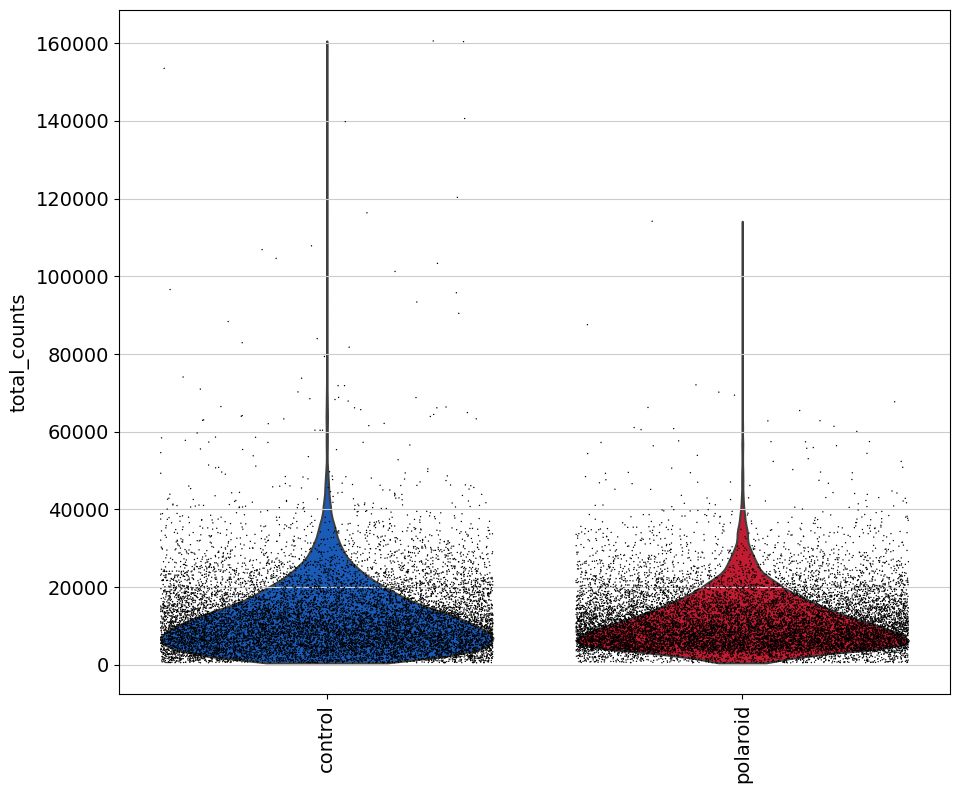

In [7]:
sc.pl.violin(adata, 'total_counts',
             groupby= "type", jitter=0.4, multi_panel=True, rotation=90)

In [8]:
# Since distirbutions are really close we will use araw average of dbls prior and cut the joint adata 



putDBLs = round(adata.obs.groupby(["type"]).size()/1000*.9).mean(axis = 0)
putDBLs =  round(adata.shape[0]/100*putDBLs)

putDBLs =   adata.obs.total_counts.sort_values()[-putDBLs:].index

adata = adata[~adata.obs_names.isin(putDBLs)]
    
    #runAdata

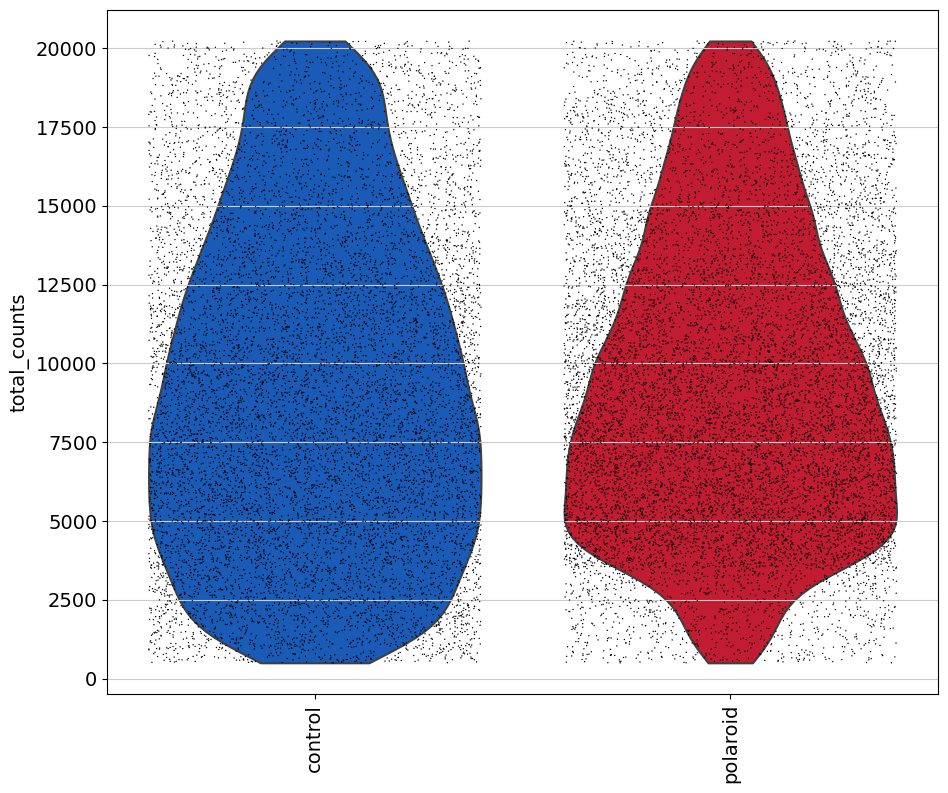

In [9]:
sc.pl.violin(adata, 'total_counts',
             groupby= "type", jitter=0.4, multi_panel=True, rotation=90)

## Mitocondrial and ribo genes

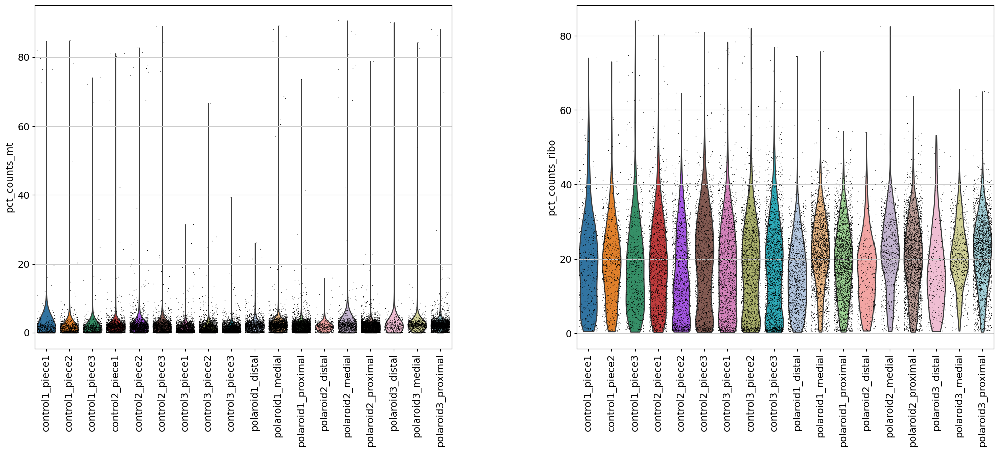

In [10]:
sc.pl.violin(adata, ['pct_counts_mt','pct_counts_ribo'],
             groupby= "dataset", jitter=0.4, multi_panel=True, rotation=90)

In [11]:
adata = adata[adata.obs.pct_counts_ribo < 40, :]
adata = adata[adata.obs.pct_counts_mt < 5, :]

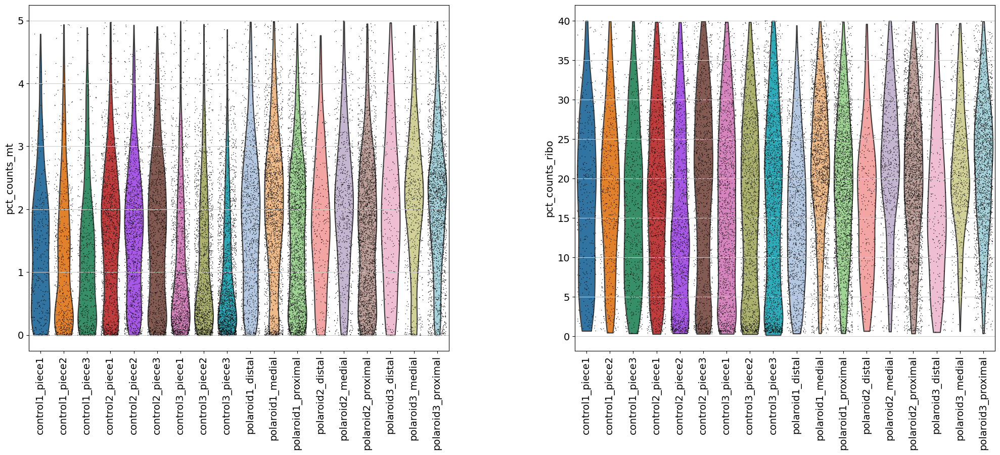

In [12]:
sc.pl.violin(adata, ['pct_counts_mt','pct_counts_ribo'],
             groupby= "dataset", jitter=0.4, multi_panel=True, rotation=90)

## min genes per cell / cells per gene

In [13]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

Trying to set attribute `.obs` of view, copying.


filtered out 5171 genes that are detected in less than 3 cells


In [14]:
adata

AnnData object with n_obs × n_vars = 22220 × 28371
    obs: 'dataset', 'organoid', 'region', 'type', 'type_region', 'regionContrast', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'dataset_colors', 'organoid_colors', 'regionContrast_colors', 'region_colors', 'type_colors'

## Normalization

In [15]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


## Joint method HVG by covariate

Here I would compute HVGs:


1) Vertical intersection = set A

    -polaroid 1,2,3 > proximal (intersection)

    -polaroid 1,2,3 > medial (intersection)

    -polaroid 1,2,3 > distal (intersection)



    -ctl 1,2,3 > P1 (intersection)

    -ctl 1,2,3 > P2 (intersection)

    -ctl 1,2,3 > P3 (intersection)


    Union of all 6
    
    



2) Horizontal intersection = set B


    - polaroid Proximal (1,2,3) vs polaroid medial (1,2,3) > 9 possible combinations (intersection)

    - polaroid Medial (1,2,3) vs polaroid distal (1,2,3) > 9 possible combinations (intersection)

    - ctl piece 1 (1,2,3) vs ctl piece 2 (1,2,3) > 9 possible combinations (intersection)
    
    - ctl piece 2 (1,2,3) vs ctl piece 3 (1,2,3) > 9 possible combinations (intersection)
    
    
    Union of all 4
    
    
  
**Finally (A).union(B)**







In [16]:
adata.obs.type_region.unique()

['control_piece2', 'control_piece1', 'control_piece3', 'polaroid_medial', 'polaroid_distal', 'polaroid_proximal']
Categories (6, object): ['control_piece2', 'control_piece1', 'control_piece3', 'polaroid_medial', 'polaroid_distal', 'polaroid_proximal']

## Vertical intersection

In [17]:
# Given the epxloratory phase as many genes were retained
VERTICAL_HVGs = {}
for group in adata.obs.type_region.unique():
    adata_group = adata[adata.obs.type_region == group].copy()
    HVGsDF = sc.pp.highly_variable_genes(adata_group, min_mean=0.0125, max_mean=3, min_disp=0.5, inplace=False, batch_key="organoid")
    VERTICAL_HVGs[group]  = set(HVGsDF[HVGsDF["highly_variable_nbatches"] == 3].index)
    
VERTICAL_HVGs = set.union(*list(VERTICAL_HVGs.values()))


extracting highly variable genes
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)


In [18]:
len(VERTICAL_HVGs)

3521

## Horizontal intersection

In [19]:
import itertools

# Setting up contrasts
proximal = ["polaroid1_proximal","polaroid2_proximal","polaroid3_proximal"]
medial = ["polaroid1_medial","polaroid2_medial","polaroid3_medial"]
distal = ["polaroid1_distal","polaroid2_distal","polaroid3_distal"]

p1 = ["control1_piece1","control2_piece1","control3_piece1"]
p2 = ["control1_piece2","control2_piece2","control3_piece2"]
p3 = ["control1_piece3","control2_piece3","control3_piece3"]

proximal_vs_medial  = list(itertools.product(proximal, medial))
medial_vs_distal  = list(itertools.product(medial, distal))

p1_vs_p2 = list(itertools.product(p1, p2))
p2_vs_p3 = list(itertools.product(p2, p3))



In [20]:
HORIZONTAL_HVGs = {}


# Proximal vs distal regions
# Proximal vs distal regions
# Proximal vs distal regions

In [21]:
proximal_vs_medial_HVGs = {}

for contrast in proximal_vs_medial:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    proximal_vs_medial_HVGs["_".join(contrast)] = HVGs

proximal_vs_medial_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(proximal_vs_medial_HVGs.values())])))
proximal_vs_medial_HVGs = set(proximal_vs_medial_HVGs.value_counts()[proximal_vs_medial_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["proximal_vs_medial_HVGs"] = proximal_vs_medial_HVGs

    
# medial vs distal regions
# medial vs distal regions
# medial vs distal regions

medial_vs_distal_HVGs = {}

for contrast in medial_vs_distal:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    medial_vs_distal_HVGs["_".join(contrast)] = HVGs

medial_vs_distal_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(medial_vs_distal_HVGs.values())])))
medial_vs_distal_HVGs = set(medial_vs_distal_HVGs.value_counts()[medial_vs_distal_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["medial_vs_distal_HVGs"] = medial_vs_distal_HVGs


# P1 vs P2
# P1 vs P2
# P1 vs P2

p1_vs_p2_HVGs = {}

for contrast in p1_vs_p2:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())
    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p1_vs_p2_HVGs["_".join(contrast)] = HVGs

p1_vs_p2_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p1_vs_p2_HVGs.values())])))
p1_vs_p2_HVGs = set(p1_vs_p2_HVGs.value_counts()[p1_vs_p2_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p1_vs_p2_HVGs"] = p1_vs_p2_HVGs



# P2 vs P3
# P2 vs P3
# P2 vs P3

p2_vs_p3_HVGs = {}

for contrast in p2_vs_p3:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p2_vs_p3_HVGs["_".join(contrast)] = HVGs

p2_vs_p3_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p2_vs_p3_HVGs.values())])))
p2_vs_p3_HVGs = set(p2_vs_p3_HVGs.value_counts()[p2_vs_p3_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p2_vs_p3_HVGs"] = p2_vs_p3_HVGs

polaroid1_proximal    2410
polaroid1_medial      1938
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    2410
polaroid2_medial       733
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    2410
polaroid3_medial       675
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid2_pro

## Combine all HVGs

In [22]:
HORIZONTAL_HVGs = set.union(*list(HORIZONTAL_HVGs.values()))

In [23]:
JointHVGs = list(HORIZONTAL_HVGs.union(VERTICAL_HVGs))

In [24]:
adata.var["highly_variable"] = adata.var_names.isin(JointHVGs)

## Storing rawdata

In [25]:
adata.raw = adata.copy()


## Scaling

In [26]:
sc.pp.scale(adata, max_value=20)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


## Explorative dimreduct

In [27]:
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)


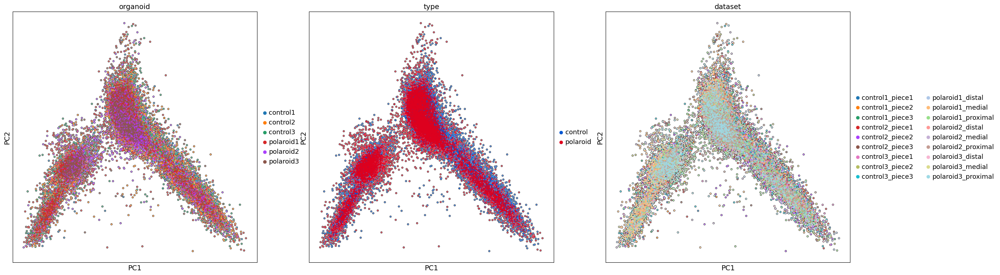

In [28]:
sc.pl.pca(adata, color=["organoid","type","dataset",], size = 30, add_outline = True,outline_width=(0.2, 0.05))

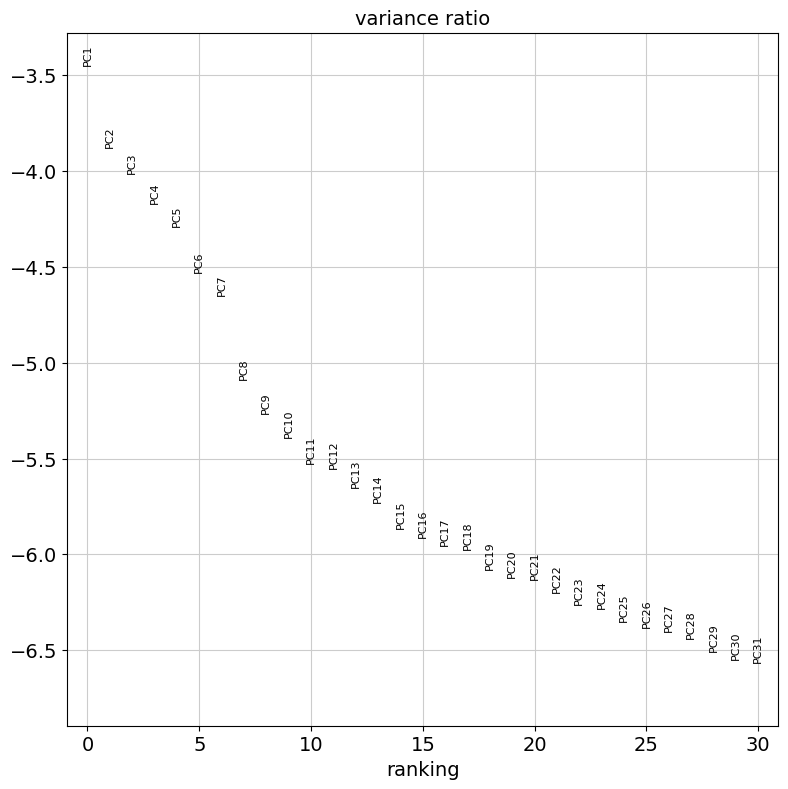

In [29]:
sc.pl.pca_variance_ratio(adata, log=True)

## Neighbors 

In [30]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)


In [31]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)


In [32]:
sc.tl.diffmap(adata)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9980042  0.9973144  0.99366105 0.9917391  0.99092036
     0.9891531  0.9869507  0.9857839  0.9838741  0.98252034 0.98203415
     0.98055375 0.9791002  0.97739536]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


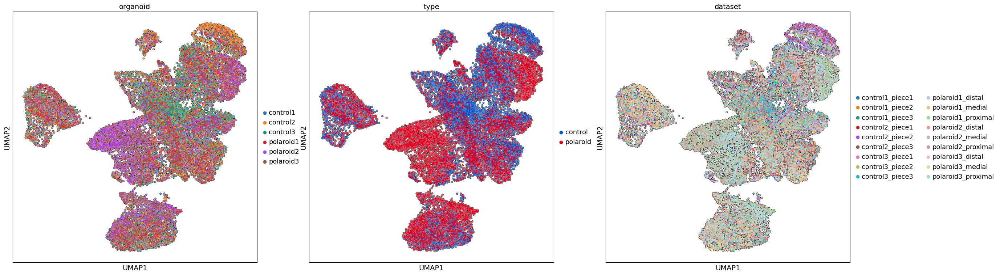

In [33]:
sc.pl.umap(adata, color=["organoid","type","dataset",], size = 30, add_outline = True,outline_width=(0.2, 0.05))

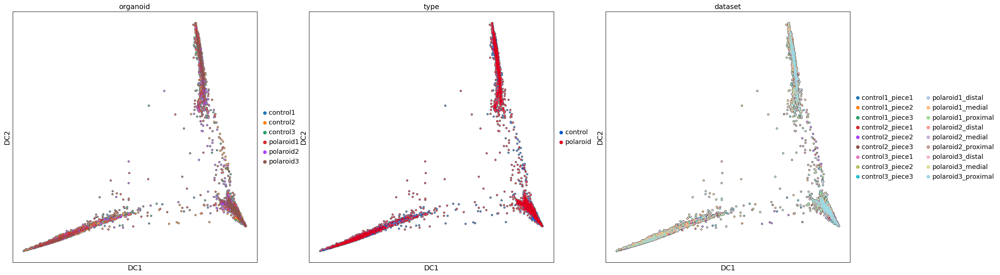

In [34]:
sc.pl.diffmap(adata, color=["organoid","type","dataset",], size = 30, add_outline = True,outline_width=(0.2, 0.05))

### DrawGraph

In [35]:
sc.tl.draw_graph(adata, n_jobs=4)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:02:33)


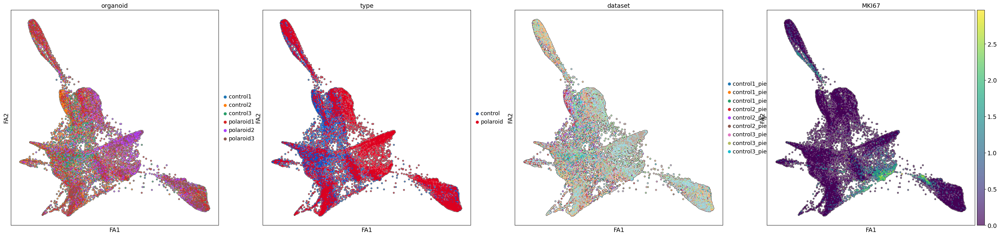

In [36]:
sc.pl.draw_graph(adata, color=["organoid","type","dataset","MKI67"], size = 30, add_outline = True,outline_width=(0.2, 0.05))

In [37]:
adata.write_h5ad(outdir+"/02A_Preprocess.h5ad")


# Gruffi

In [38]:
adata = sc.read_h5ad(outdir+"/02A_Preprocess.h5ad")

In [39]:
print(adata.obsp["connectivities"].data)
print(adata.obsp["distances"])

[0.15580252  0.13195293  1.          ... 0.13278878  0.075919725
 0.11208251 ]
  (0, 1048)	12.065792083740234
  (0, 1769)	9.329296112060547
  (0, 1821)	11.881159782409668
  (0, 3178)	12.285615921020508
  (0, 4778)	9.072836875915527
  (0, 5245)	12.623744010925293
  (0, 5631)	12.39741039276123
  (0, 6303)	8.042698860168457
  (0, 6690)	10.714126586914062
  (0, 7250)	10.81225872039795
  (0, 8621)	10.401694297790527
  (0, 8724)	9.853194236755371
  (0, 9113)	8.979679107666016
  (0, 9193)	10.61874008178711
  (0, 9288)	11.086877822875977
  (0, 10187)	12.657814025878906
  (0, 10188)	10.93688678741455
  (0, 10257)	7.547016620635986
  (0, 11823)	11.791207313537598
  (1, 1141)	9.481132507324219
  (1, 1298)	8.799959182739258
  (1, 1474)	9.789313316345215
  (1, 1498)	9.047750473022461
  (1, 1767)	9.519059181213379
  (1, 1818)	9.610590934753418
  :	:
  (22218, 21114)	9.191518783569336
  (22218, 21671)	5.599649429321289
  (22218, 21816)	8.500561714172363
  (22218, 21835)	8.81576919555664
  (22218, 219

In [40]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [41]:
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [42]:
anndata2ri.activate()

In [43]:
adata_no_knn_all = adata.copy()
adata_no_knn_all.obsp = None
adata_no_knn_all.uns.pop("neighbors")

HVGsList = adata_no_knn_all.var[adata_no_knn_all.var["highly_variable"]].index.tolist()
len(HVGsList)

3536

In [44]:
%load_ext rpy2.ipython

In [45]:
%%R
library(gruffi)
library(MarkdownReports)


In [46]:
%%R -i adata_no_knn_all -i HVGsList

adata_no_knn_all_SOBJ <- as.Seurat(adata_no_knn_all, counts = "X", data = "X")
adata_no_knn_all_SOBJ@reductions$pca <- adata_no_knn_all_SOBJ@reductions$PCA
VariableFeatures(adata_no_knn_all_SOBJ) <- HVGsList
adata_no_knn_all_SOBJ <- FindNeighbors(adata_no_knn_all_SOBJ, dims = 1:50,features = HVGsList)
adata_no_knn_all_SOBJ <- Seurat.utils::SetupReductionsNtoKdimensions(obj = adata_no_knn_all_SOBJ, nPCs = 50, dimensions=3:2, reduction="umap")
adata_no_knn_all_SOBJ <- aut.res.clustering(obj = adata_no_knn_all_SOBJ, assay="originalexp" )
adata_no_knn_all_SOBJ@assays$RNA <- adata_no_knn_all_SOBJ@assays$originalexp


[1] "3 dimensional umap is calculated"
[1] "2 dimensional umap is calculated"
[1] "Current clustering resolution: 2"
[1] "Current median cluster size: 532"
[1] "Search between 2 and 22."
[1] "Suggested resolution is 12 and the respective clustering is stored in Idents(obj) and in @meta.data. The median numbers of cells per cluster is 171.5. The number of clusters is 128"


## Store GOs

In [47]:
%%R

ensembl <- biomaRt::useEnsembl("ensembl", dataset = "hsapiens_gene_ensembl", version="107")

go1 <- "GO:0006096" # Glycolysis
go2 <- "GO:0034976" # ER-stress
go3 <- "GO:0042063" # Gliogenesis, negative filtering

## Granular clusters

In [48]:
%%R

granule.res.4.gruffi <- adata_no_knn_all_SOBJ@misc$gruffi$'optimal.granule.res'
adata_no_knn_all_SOBJ <- reassign.small.clusters(adata_no_knn_all_SOBJ, ident = granule.res.4.gruffi) # will be stored in meta data column as "seurat_clusters.reassigned"
granule.res.4.gruffi <- paste0(granule.res.4.gruffi, '.reassigned')


[1] "1 clusters have < 30 cells, which need to be reassigned."
[1] "THE 3D UMAP IN @misc$'reductions.backup WILL BE USED."
[1] "cluster: 127"
[1] "originalexp_snn_res.12.reassigned"
[1] "Call plot.clust.size.distr() to check results."


## Score stress

In [49]:
%%R

adata_no_knn_all_SOBJ <- GO_score_evaluation(obj = adata_no_knn_all_SOBJ, GO_term = go1, save.UMAP = TRUE, new_GO_term_computation = T, clustering = granule.res.4.gruffi, plot.each.gene = F)

# ER stress 	GO:0034976
adata_no_knn_all_SOBJ <- GO_score_evaluation(obj = adata_no_knn_all_SOBJ, GO_term = go2, save.UMAP = TRUE, new_GO_term_computation = T, clustering = granule.res.4.gruffi, plot.each.gene = F)

# Gliogenesis		GO:0042063
adata_no_knn_all_SOBJ <- GO_score_evaluation(obj = adata_no_knn_all_SOBJ, GO_term = go3, save.UMAP = TRUE, new_GO_term_computation = T, clustering = granule.res.4.gruffi, plot.each.gene = F)

[1] "Score.GO.0006096"
[1] "For GO score computation assay is set to RNA. It will be reset to Seurat::DefaultAssay() afterwards."
[1] "Score.GO.0006096 not found. Need to call GetGOTerms(). set only.draw.plot = FALSE."
[1] "GENE SCORE WILL NOW BE SET / OVERWRITTEN"
[1] "GetGOTerms()"
[1] "83 Gene symbols downloaded: PKLR GPI SLC2A6 APP EP300 HTR2A LDHA PGK2 PFKL DHTKD1"
[1] "83 Gene symbols downloaded: PKLR GPI SLC2A6 APP EP300 HTR2A LDHA PGK2 PFKL DHTKD1"
[1] "IntersectWithExpressed()"
[1] "4 genes (of 83 ) are MISSING from the Seurat object: PGK2 PRXL2C IFNG TREX1"
[1] "Genes in GO:0006096 are saved under obj@misc$GO$ GO.0006096"
[1] "ENO1"   "MTOR"   "PRKAA2" "PGM1"   "ARNT"   "PKLR"  
[1] "AddGOScore()"
[1] "Trailing '1' in metadata column name is removed. Column name: Score.GO.0006096"
[1] "OutDir not defined !!! Saving in working directory."
[1] "/group/testa/Users/davide.castaldi/Polaroid_publication/Notebooks_release_2/FeaturePlot.Score.GO.0006096..png"
[1] "Calculating cl. ave

In [50]:
%%R

(i1 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go1))
(i2 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go2))
(i3 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go3))

[1] "originalexp_snn_res.12.reassigned_cl.av_GO:0042063"


# Custom gruffi function

In [51]:
%%R

Shiny.GO.thresh <- function(obj = combined.obj
                            , proposed.method = c("fitted","empirical")[1]
                            , quantile = c(.99,.9)[1]
                            , stress.ident1 = paste0(Seurat.utils::GetClusteringRuns(obj)[1],"_cl.av_GO:0006096")
                            , stress.ident2 = paste0(Seurat.utils::GetClusteringRuns(obj)[1],"_cl.av_GO:0034976")
                            , notstress.ident3 = paste0(Seurat.utils::GetClusteringRuns(obj)[1],"_cl.av_GO:0042063")
                            , notstress.ident4 = NULL
                            , plot.cluster.shiny = Seurat.utils::GetClusteringRuns(obj)[1]
                            , call.shiny.app = TRUE)  {
  app_env <- new.env()
  meta <- obj@meta.data

  if(!is.null(stress.ident1)) stopifnot(stress.ident1 %in% colnames(meta))
  if(!is.null(stress.ident2)) stopifnot(stress.ident2 %in% colnames(meta))
  if(!is.null(notstress.ident3)) stopifnot(notstress.ident3 %in% colnames(meta))
  if(!is.null(notstress.ident4)) stopifnot(notstress.ident4 %in% colnames(meta))

  av.stress.ident1 <- as.numeric(levels(meta[,stress.ident1]))
  av.stress.ident2 <- as.numeric(levels(meta[,stress.ident2]))
  av.notstress.ident3 <- as.numeric(levels(meta[,notstress.ident3]))
  av.notstress.ident4 <- as.numeric(levels(meta[,notstress.ident4]))

  if(call.shiny.app) {

    # compute proposals for thresholds
    app_env$thresh.stress.ident1 <- PlotNormAndSkew(av.stress.ident1, q = quantile, tresholding = proposed.method, plot.hist = F)
    app_env$thresh.stress.ident2 <- PlotNormAndSkew(av.stress.ident2, q = quantile, tresholding = proposed.method, plot.hist = F)
    app_env$thresh.notstress.ident3 <- PlotNormAndSkew(av.notstress.ident3, q = quantile, tresholding = proposed.method, plot.hist = F)
    app_env$thresh.notstress.ident4 <- PlotNormAndSkew(av.notstress.ident4, q = quantile, tresholding = proposed.method, plot.hist = F)

    min.x.stress.ident1 <- floor(min(av.stress.ident1, app_env$thresh.stress.ident1))
    max.x.stress.ident1 <- ceiling(max(av.stress.ident1, app_env$thresh.stress.ident1))
    step.stress.ident1  <- 0.001

    min.x.stress.ident2 <- floor(min(av.stress.ident2, app_env$thresh.stress.ident2))
    max.x.stress.ident2 <- ceiling(max(av.stress.ident2, app_env$thresh.stress.ident2))
    step.stress.ident2  <- 0.001

    min.x.notstress.ident3 <- floor(min(av.notstress.ident3, app_env$thresh.notstress.ident3))
    max.x.notstress.ident3 <- ceiling(max(av.notstress.ident3, app_env$thresh.notstress.ident3))
    step.notstress.ident3  <- 0.001

    min.x.notstress.ident4 <- floor(min(av.notstress.ident4, app_env$thresh.notstress.ident4))
    max.x.notstress.ident4 <- ceiling(max(av.notstress.ident4, app_env$thresh.notstress.ident4))
    step.notstress.ident4  <- 0.001

    app_env$idents <- list(stress.ident1 = stress.ident1,
                           stress.ident2 = stress.ident2,
                           notstress.ident3 = notstress.ident3,
                           notstress.ident4 = notstress.ident4)

    app_env$sliders <- list(min.x.stress.ident1 = min.x.stress.ident1, max.x.stress.ident1 = max.x.stress.ident1, step.stress.ident1 = step.stress.ident1,
                            min.x.stress.ident2 = min.x.stress.ident2, max.x.stress.ident2 = max.x.stress.ident2, step.stress.ident2 = step.stress.ident2,
                            min.x.notstress.ident3 = min.x.notstress.ident3, max.x.notstress.ident3 = max.x.notstress.ident3, step.notstress.ident3 = step.notstress.ident3,
                            min.x.notstress.ident4 = min.x.notstress.ident4, max.x.notstress.ident4 = max.x.notstress.ident4, step.notstress.ident4 = step.notstress.ident4)

    app_env$average.vec <- list(av.stress.ident1 = av.stress.ident1,
                                av.stress.ident2 = av.stress.ident2,
                                av.notstress.ident3 = av.notstress.ident3,
                                av.notstress.ident4 = av.notstress.ident4)
    app_env$obj <- obj
    app_env$plot.cluster.shiny <- plot.cluster.shiny

    app_dir <- system.file("shiny", "GO.thresh", package = "gruffi")
    app_ui <- source(file.path(app_dir, "ui.R"), local=new.env(parent=app_env),
                     echo=FALSE, keep.source=TRUE)$value
    app_server <- source(file.path(app_dir, "server.R"), local=new.env(parent=app_env),
                         echo=FALSE, keep.source=TRUE)$value
    obj <- shiny::runApp(shiny::shinyApp(app_ui, app_server))

  } else {
    # compute proposals for thresholds
    thresh.stress.ident1 <- PlotNormAndSkew(av.stress.ident1, q = quantile, tresholding = proposed.method, plot.hist = F)
    thresh.stress.ident2 <- PlotNormAndSkew(av.stress.ident2, q = quantile, tresholding = proposed.method, plot.hist = F)
    thresh.notstress.ident3 <- PlotNormAndSkew(av.notstress.ident3, q = quantile, tresholding = proposed.method, plot.hist = F)
    thresh.notstress.ident4 <- PlotNormAndSkew(av.notstress.ident4, q = quantile, tresholding = proposed.method, plot.hist = F)

    if(!is.null(stress.ident1)) {
      obj@misc$gruffi$thresh.stress.ident1 <- thresh.stress.ident1
      obj$stress.ident1.thresh_cluster <- as.numeric(levels(obj@meta.data[,stress.ident1]))[obj@meta.data[,stress.ident1]] > thresh.stress.ident1
      obj$stress.ident1.thresh_cluster[obj$stress.ident1.thresh_cluster == FALSE] <- F
      obj$stress.ident1.thresh_cluster[obj$stress.ident1.thresh_cluster == TRUE] <- T
    }
    if(!is.null(stress.ident2)) {
      obj@misc$gruffi$thresh.stress.ident2 <- thresh.stress.ident2
      obj$stress.ident2.thresh_cluster <- as.numeric(levels(obj@meta.data[,stress.ident2]))[obj@meta.data[,stress.ident2]] > thresh.stress.ident2
      obj$stress.ident2.thresh_cluster[obj$stress.ident2.thresh_cluster == FALSE] <- F
      obj$stress.ident2.thresh_cluster[obj$stress.ident2.thresh_cluster == TRUE] <- T
    }
    if(!is.null(notstress.ident3)) {
      obj@misc$gruffi$thresh.notstress.ident3 <- thresh.notstress.ident3
      obj$notstress.ident3.thresh_cluster <- as.numeric(levels(obj@meta.data[,notstress.ident3]))[obj@meta.data[,notstress.ident3]] > thresh.notstress.ident3
      obj$notstress.ident3.thresh_cluster[obj$notstress.ident3.thresh_cluster == FALSE] <- F
      obj$notstress.ident3.thresh_cluster[obj$notstress.ident3.thresh_cluster == TRUE] <- T
    }
    if(!is.null(notstress.ident4)) {
      obj@misc$gruffi$thresh.notstress.ident4 <- thresh.notstress.ident4
      obj$notstress.ident4.thresh_cluster <- as.numeric(levels(obj@meta.data[,notstress.ident4]))[obj@meta.data[,notstress.ident4]] > thresh.notstress.ident4
      obj$notstress.ident4.thresh_cluster[obj$notstress.ident4.thresh_cluster == FALSE] <- F
      obj$notstress.ident4.thresh_cluster[obj$notstress.ident4.thresh_cluster == TRUE] <- T
    }

    if(!is.null(stress.ident1)) {
      i1.bool <- as.numeric(levels(obj@meta.data[,stress.ident1]))[obj@meta.data[,stress.ident1]] > thresh.stress.ident1
      if(!is.null(stress.ident2)) {
        i2.bool <- as.numeric(levels(obj@meta.data[,stress.ident2]))[obj@meta.data[,stress.ident2]] > thresh.stress.ident2
        stress.bool <- i1.bool | i2.bool
      }
      else {
        stress.bool <- i1.bool
      }
    } else {
      if(!is.null(stress.ident2)) {
        i2.bool <- as.numeric(levels(obj@meta.data[,stress.ident2]))[obj@meta.data[,stress.ident2]] > thresh.stress.ident2
        stress.bool <- i2.bool
      }
    }

    notstress.bool <- NULL
    if(!is.null(notstress.ident3)) {
      i3.bool <- as.numeric(levels(obj@meta.data[,notstress.ident3]))[obj@meta.data[,notstress.ident3]] > thresh.notstress.ident3
      if(!is.null(notstress.ident4)) {
        i4.bool <- as.numeric(levels(obj@meta.data[,notstress.ident4]))[obj@meta.data[,notstress.ident4]] > thresh.notstress.ident4
        notstress.bool <- i3.bool | i4.bool
      }
      else {
        notstress.bool <- i3.bool
      }
    } else {
      if(!is.null(notstress.ident4)) {
        i4.bool <- as.numeric(levels(obj@meta.data[,notstress.ident4]))[obj@meta.data[,notstress.ident4]] > thresh.notstress.ident4
        notstress.bool <- i4.bool
      }
    }

    if(!is.null(notstress.bool)) {
      obj$is.Stressed <- stress.bool & !notstress.bool
    } else {
      obj$is.Stressed <- stress.bool
    }

    ptlist <- list()
    count <- 1
    if(!is.null(stress.ident1)) {
      ptlist[[count]] <- Seurat::FeaturePlot(obj =  obj, features = ww.convert.GO_term.2.score(paste0(substr(x = strsplit(stress.ident1, "cl.av")[[1]][2], 2, nchar(strsplit(stress.ident1, "cl.av")[[1]][2])))), min.cutoff = "q01", max.cutoff = "q99")+Seurat::NoLegend()+Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(stress.ident2)) {
      ptlist[[count]] <- Seurat::FeaturePlot(obj =  obj, features = ww.convert.GO_term.2.score(paste0(substr(x = strsplit(stress.ident2, "cl.av")[[1]][2], 2, nchar(strsplit(stress.ident2, "cl.av")[[1]][2])))), min.cutoff = "q01", max.cutoff = "q99")+Seurat::NoLegend()+Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(notstress.ident3)) {
      ptlist[[count]] <- Seurat::FeaturePlot(obj =  obj, features = ww.convert.GO_term.2.score(paste0(substr(x = strsplit(notstress.ident3, "cl.av")[[1]][2], 2, nchar(strsplit(notstress.ident3, "cl.av")[[1]][2])))), min.cutoff = "q01", max.cutoff = "q99")+Seurat::NoLegend()+Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(notstress.ident4)) {
      ptlist[[count]] <- Seurat::FeaturePlot(obj =  obj, features = ww.convert.GO_term.2.score(paste0(substr(x = strsplit(notstress.ident4, "cl.av")[[1]][2], 2, nchar(strsplit(notstress.ident4, "cl.av")[[1]][2])))), min.cutoff = "q01", max.cutoff = "q99")+Seurat::NoLegend()+Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(stress.ident1)) {
      ptlist[[count]] <- Seurat.utils::clUMAP(obj = obj, ident = "stress.ident1.thresh_cluster", save.plot = F, aspect.ratio = 1) +
        ggplot2::ggtitle(ggplot2::element_blank()) +
        ggplot2::scale_color_manual(values=c(Seurat.utils::gg_color_hue(2)[2], Seurat.utils::gg_color_hue(2)[1]))+ Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(stress.ident2)) {
      ptlist[[count]] <- Seurat.utils::clUMAP(obj = obj, ident = "stress.ident2.thresh_cluster", save.plot = F, aspect.ratio = 1) +
        ggplot2::ggtitle(ggplot2::element_blank()) +
        ggplot2::scale_color_manual(values=c(Seurat.utils::gg_color_hue(2)[2], Seurat.utils::gg_color_hue(2)[1]))+ Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(notstress.ident3)) {
      ptlist[[count]] <- Seurat.utils::clUMAP(obj = obj, ident = "notstress.ident3.thresh_cluster", save.plot = F, aspect.ratio = 1) +
        ggplot2::ggtitle(ggplot2::element_blank()) +
        ggplot2::scale_color_manual(values=c(Seurat.utils::gg_color_hue(2)[1], Seurat.utils::gg_color_hue(2)[2]))+ Seurat::NoAxes()
      count <- count + 1
    }
    if(!is.null(notstress.ident4)) {
      ptlist[[count]] <- Seurat.utils::clUMAP(obj = obj, ident = "notstress.ident4.thresh_cluster", save.plot = F, aspect.ratio = 1) +
        ggplot2::ggtitle(ggplot2::element_blank()) +
        ggplot2::scale_color_manual(values=c(Seurat.utils::gg_color_hue(2)[1], Seurat.utils::gg_color_hue(2)[2]))+ Seurat::NoAxes()
      count <- count + 1
    }
    message("The Shiny interface was not called, please check the proposed thresholds manually! GO term specific UMAPs will be plotted.")
    gridExtra::grid.arrange(grobs=ptlist,ncol=ceiling(length(ptlist)/2), title = "GO score")
  }
  print(CodeAndRoll2::pc_TRUE(stress.bool, suffix = "of cells are classified as stressed. Adapt individual score-thresholds if deemed inaccurate."))
  return(obj)
}

[1] "16.4 % of cells are classified as stressed. Adapt individual score-thresholds if deemed inaccurate."


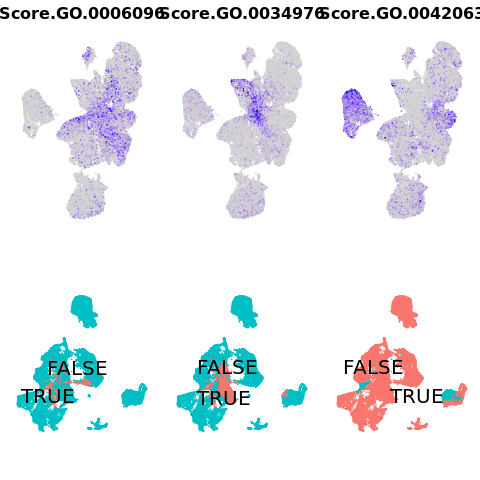

In [52]:
%%R

adata_no_knn_all_SOBJ <- Shiny.GO.thresh(obj = adata_no_knn_all_SOBJ,
                call.shiny.app = FALSE,
                                stress.ident1 = i1,
                                stress.ident2 = i2,
                                notstress.ident3 = i3,
                                plot.cluster.shiny = "orig.ident")

In [53]:
%%R -o ScoresDF

ScoresDF <- adata_no_knn_all_SOBJ@meta.data["is.Stressed"]

## shiny backup

%%R

(i1 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go1))
(i2 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go2))
(i3 <- Stringendo::kppu(granule.res.4.gruffi, 'cl.av', go3))

adata_no_knn_all_SOBJ <- Shiny.GO.thresh(obj = adata_no_knn_all_SOBJ,
                                stress.ident1 = i1,
                                stress.ident2 = i2,
                                notstress.ident3 = i3,
                                plot.cluster.shiny = "orig.ident")

"Dont forget to click the button in the app: Save New Thresholds"


## Go back to anndata

In [54]:
adata.obs = pd.concat([adata.obs, ScoresDF],axis = 1)

In [55]:
adata.obs["is.Stressed"] = adata.obs["is.Stressed"].replace({0:"not_stressed",1:"stressed"})

... storing 'is.Stressed' as categorical


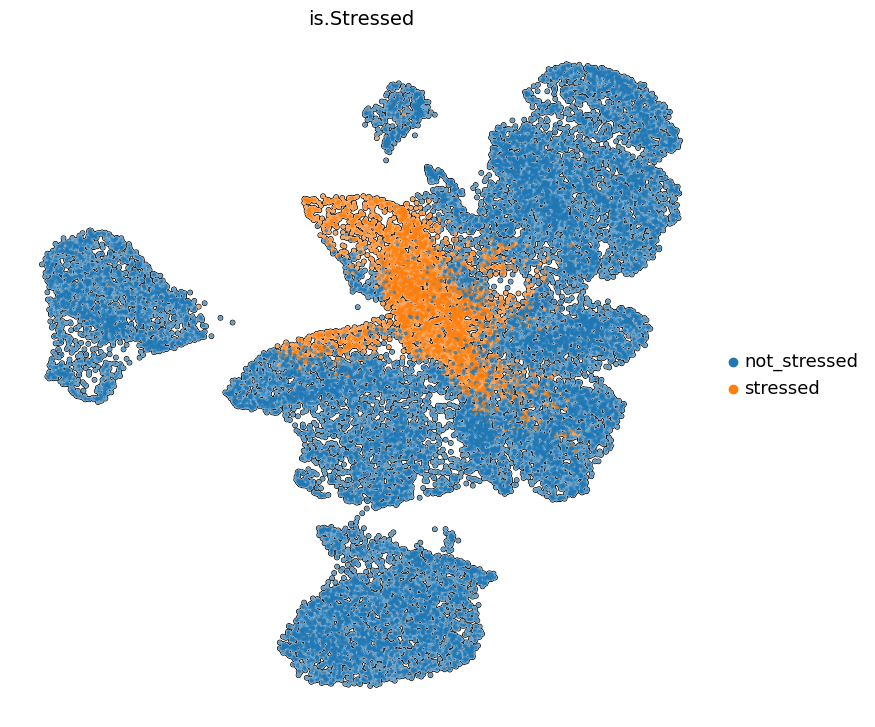

In [56]:
sc.pl.umap(adata, color=["is.Stressed"], size = 30, add_outline = True,outline_width=(0.2, 0.05), ncols = 2,frameon=False,
           save=nb_fname+".stressLoc.UMAP.pdf")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
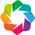

:Sankey   [region,is.Stressed]   (count)

In [57]:
import holoviews as hv
from bokeh.io import export_svgs

obsTupleToMap = ("region","is.Stressed")
SankeyDF=adata.obs[list(obsTupleToMap)]
SankeyDF.columns = ["region","is.Stressed"]
SankeyDF = SankeyDF.groupby(['region','is.Stressed']).size().reset_index().rename(columns={0:'count'})
SankeyDF=SankeyDF[SankeyDF["count"] != 0]
hv.extension('bokeh')

SankeyDF.to_csv(outdir+"/SankeyDF.tsv", sep="\t")

sankey1 = hv.Sankey(SankeyDF, kdims=["region", "is.Stressed"], vdims="count")



sankey1.opts(cmap='Colorblind',label_position='outer',
edge_color='region', edge_line_width=0,
node_alpha=1.0, node_width=40, node_sort=True,
width=1100, height=700, bgcolor="white")

#hv.save(sankey1, './Figures_publication/StressedCells.png', fmt='png')

## Filtering stressed cells

In [58]:
print(adata)

print(adata[adata.obs["is.Stressed"] == "not_stressed" ] )

adata = adata[adata.obs["is.Stressed"] == "not_stressed" ]

adata.write_h5ad(outdir+"/02B_Preprocess_Gruffi_filtered.h5ad")

AnnData object with n_obs × n_vars = 22220 × 28371
    obs: 'dataset', 'organoid', 'region', 'type', 'type_region', 'regionContrast', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'is.Stressed'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'mean', 'std'
    uns: 'dataset_colors', 'diffmap_evals', 'draw_graph', 'neighbors', 'organoid_colors', 'pca', 'regionContrast_colors', 'region_colors', 'type_colors', 'umap', 'is.Stressed_colors'
    obsm: 'X_diffmap', 'X_draw_graph_fa', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
View of AnnData object with n_obs × n_vars = 18822 × 28371
    obs: 'dataset', 'organoid', 'region', 'type', 'type_region', 'regionContrast',

In [59]:
adata.write_h5ad(outdir+"/02B_Preprocess_Gruffi_filtered.h5ad")

# Re-process

In [60]:
adata = sc.read_h5ad(outdir+"/02B_Preprocess_Gruffi_filtered.h5ad")

In [61]:
adata = adata.raw.to_adata().copy()

## HVGSto_adata

## Vertical intersection

In [62]:
# Given the epxloratory phase as many genes were retained
VERTICAL_HVGs = {}
for group in adata.obs.type_region.unique():
    adata_group = adata[adata.obs.type_region == group].copy()
    HVGsDF = sc.pp.highly_variable_genes(adata_group, min_mean=0.0125, max_mean=3, min_disp=0.5, inplace=False, batch_key="organoid")
    VERTICAL_HVGs[group]  = set(HVGsDF[HVGsDF["highly_variable_nbatches"] == 3].index)
    
VERTICAL_HVGs = set.union(*list(VERTICAL_HVGs.values()))


extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)


In [63]:
len(VERTICAL_HVGs)

3377

## Horizontal intersection

In [64]:
import itertools

# Setting up contrasts
proximal = ["polaroid1_proximal","polaroid2_proximal","polaroid3_proximal"]
medial = ["polaroid1_medial","polaroid2_medial","polaroid3_medial"]
distal = ["polaroid1_distal","polaroid2_distal","polaroid3_distal"]

p1 = ["control1_piece1","control2_piece1","control3_piece1"]
p2 = ["control1_piece2","control2_piece2","control3_piece2"]
p3 = ["control1_piece3","control2_piece3","control3_piece3"]

proximal_vs_medial  = list(itertools.product(proximal, medial))
medial_vs_distal  = list(itertools.product(medial, distal))

p1_vs_p2 = list(itertools.product(p1, p2))
p2_vs_p3 = list(itertools.product(p2, p3))



In [65]:
HORIZONTAL_HVGs = {}


# Proximal vs distal regions
# Proximal vs distal regions
# Proximal vs distal regions

In [66]:
proximal_vs_medial_HVGs = {}

for contrast in proximal_vs_medial:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    proximal_vs_medial_HVGs["_".join(contrast)] = HVGs

proximal_vs_medial_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(proximal_vs_medial_HVGs.values())])))
proximal_vs_medial_HVGs = set(proximal_vs_medial_HVGs.value_counts()[proximal_vs_medial_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["proximal_vs_medial_HVGs"] = proximal_vs_medial_HVGs

    
# medial vs distal regions
# medial vs distal regions
# medial vs distal regions

medial_vs_distal_HVGs = {}

for contrast in medial_vs_distal:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    medial_vs_distal_HVGs["_".join(contrast)] = HVGs

medial_vs_distal_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(medial_vs_distal_HVGs.values())])))
medial_vs_distal_HVGs = set(medial_vs_distal_HVGs.value_counts()[medial_vs_distal_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["medial_vs_distal_HVGs"] = medial_vs_distal_HVGs


# P1 vs P2
# P1 vs P2
# P1 vs P2

p1_vs_p2_HVGs = {}

for contrast in p1_vs_p2:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())
    
    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p1_vs_p2_HVGs["_".join(contrast)] = HVGs

p1_vs_p2_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p1_vs_p2_HVGs.values())])))
p1_vs_p2_HVGs = set(p1_vs_p2_HVGs.value_counts()[p1_vs_p2_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p1_vs_p2_HVGs"] = p1_vs_p2_HVGs



# P2 vs P3
# P2 vs P3
# P2 vs P3

p2_vs_p3_HVGs = {}

for contrast in p2_vs_p3:
    
    adataContrast = adata[adata.obs["dataset"].isin(list(contrast))].copy()
    print(adataContrast.obs.dataset.value_counts())

    sc.pp.highly_variable_genes(adataContrast, min_mean=0.0125, max_mean=3, min_disp=0.5)
    HVGs = set(adataContrast.var[adataContrast.var.highly_variable].index.tolist())
    p2_vs_p3_HVGs["_".join(contrast)] = HVGs

p2_vs_p3_HVGs = pd.Series(list(itertools.chain.from_iterable([list(i) for i in list(p2_vs_p3_HVGs.values())])))
p2_vs_p3_HVGs = set(p2_vs_p3_HVGs.value_counts()[p2_vs_p3_HVGs.value_counts() == 9].index.tolist())
HORIZONTAL_HVGs["p2_vs_p3_HVGs"] = p2_vs_p3_HVGs

polaroid1_proximal    2076
polaroid1_medial      1733
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    2076
polaroid2_medial       670
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid1_proximal    2076
polaroid3_medial       616
Name: dataset, dtype: int64
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
polaroid2_pro

## Combine all HVGs

In [67]:
HORIZONTAL_HVGs = set.union(*list(HORIZONTAL_HVGs.values()))

In [68]:
JointHVGs = list(HORIZONTAL_HVGs.union(VERTICAL_HVGs))

In [69]:
adata.var["highly_variable"] = adata.var_names.isin(JointHVGs)

## Storing rawdata

In [70]:
adata.raw = adata.copy()


## Scaling

In [71]:
sc.pp.scale(adata, max_value=20)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


## Explorative dimreduct

In [72]:
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


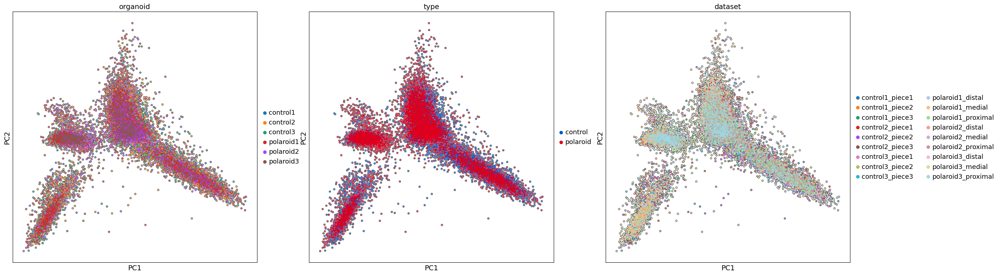

In [73]:
sc.pl.pca(adata, color=["organoid","type","dataset",], size = 30, add_outline = True,outline_width=(0.2, 0.05))

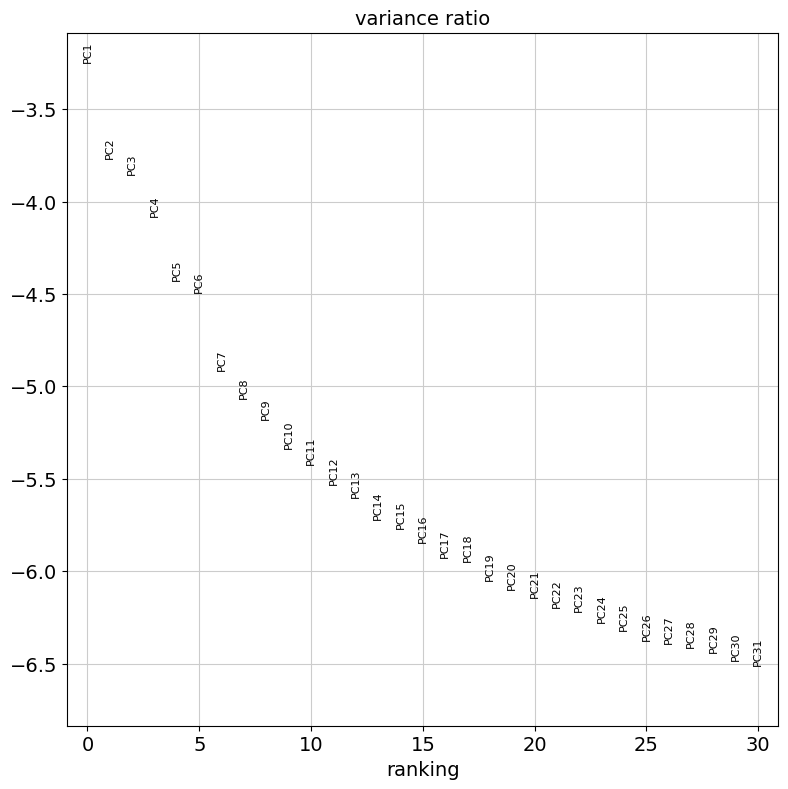

In [74]:
sc.pl.pca_variance_ratio(adata, log=True)

## Neighbors 

In [75]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [76]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)


In [77]:
sc.tl.diffmap(adata)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9980236  0.99751395 0.99457854 0.9930555  0.9916404
     0.98803663 0.9859242  0.9842043  0.98254275 0.981802   0.9785987
     0.97799367 0.9754154  0.9751553 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


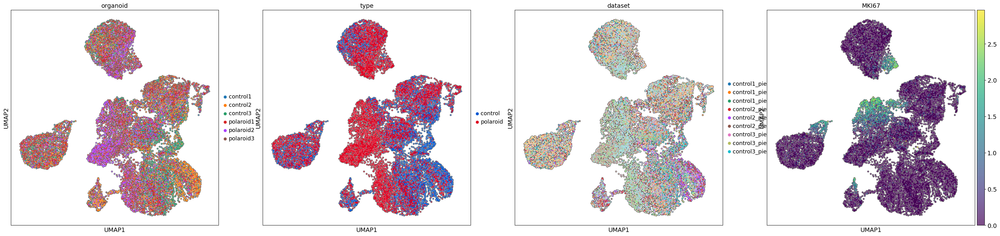

In [78]:
sc.pl.umap(adata, color=["organoid","type","dataset","MKI67"], size = 30, add_outline = True,outline_width=(0.2, 0.05))

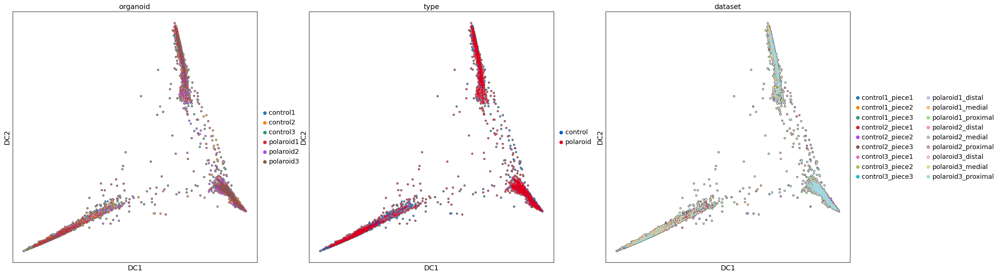

In [79]:
sc.pl.diffmap(adata, color=["organoid","type","dataset",], size = 30, add_outline = True,outline_width=(0.2, 0.05))

### DrawGraph

In [80]:
sc.tl.draw_graph(adata, n_jobs=4)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:02:17)


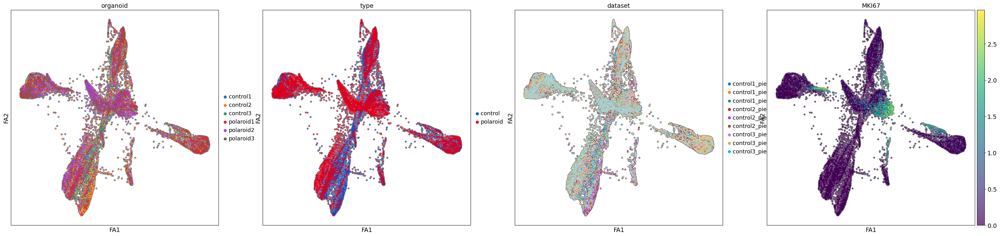

In [81]:
sc.pl.draw_graph(adata, color=["organoid","type","dataset","MKI67"], size = 30, add_outline = True,outline_width=(0.2, 0.05))

In [82]:
adata.write_h5ad(outdir+"/02C_Preprocess_final.h5ad")
